In [1]:
import os, random, numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.utils.data as data
import torchvision.datasets as dataset
import torchvision.transforms as transforms
import torchvision.utils as vutils
from IPython.display import HTML

manual_seed = 69
random.seed(manual_seed)
torch.manual_seed(manual_seed)

In [2]:
workers = 2
batch_size = 128
image_size = 64
nc = 3 # number of channels (R, G, B)
nz = 100 # size of z latent vector
ngf = 64 # size of feature maps in generator
ndf = 64 # size of feature maps in discriminator
num_epochs = 5
lr = 0.0002
beta1 = 0.5

In [3]:
img_transforms = transforms.Compose([
    transforms.Resize(image_size),
    transforms.CenterCrop(image_size),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
])

In [4]:
dataset = dataset.CelebA(root='data/celeba', split='train', transform=img_transforms, download=True)

1443490838it [00:14, 99091476.90it/s]
26721026it [00:00, 129766227.69it/s]
3424458it [00:00, 189661009.19it/s]
6082035it [00:00, 136454542.06it/s]
12156055it [00:00, 146054989.16it/s]
2836386it [00:00, 127213930.57it/s]


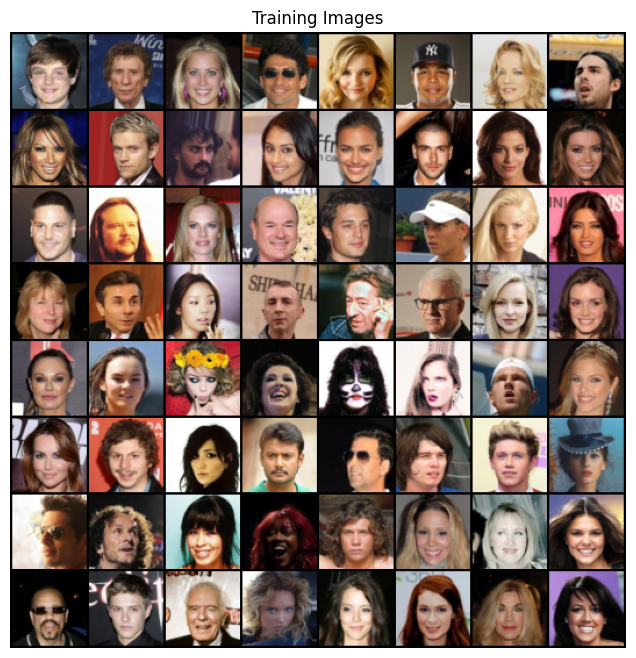

In [5]:
dataloader = data.DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=workers)
device = 'cuda' if torch.cuda.is_available() else 'cpu'

real_batch = next(iter(dataloader))
plt.figure(figsize=(8, 8))
plt.axis('off')
plt.title('Training Images')
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(), (1, 2, 0)))

In [6]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [8]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is z, going into convolution
            nn.ConvTranspose2d(nz, ngf*8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf*8),
            nn.ReLU(True),
            # state size. ``(ngf*8)x4x4``
            nn.ConvTranspose2d(ngf*8, ngf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*4),
            nn.ReLU(True),
            # state size. ``(ngf*4)x8x8``
            nn.ConvTranspose2d(ngf*4, ngf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf*2),
            nn.ReLU(True),
            # state size. ``(ngf*2)x16x16``
            nn.ConvTranspose2d(ngf*2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. ``(ngf)x32x32``
            nn.ConvTranspose2d(ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. ``(nc)x64x64``
        )

    def forward(self, input):
        return self.main(input)

In [9]:
net_g = Generator().to(device)
net_g.apply(weights_init)
print(net_g)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [10]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main = nn.Sequential(
            # input is ``(nc)x64x64``
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf)x32x32``
            nn.Conv2d(ndf, ndf*2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*2)x16x16``
            nn.Conv2d(ndf*2, ndf*4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*4)x8x8``
            nn.Conv2d(ndf*4, ndf*8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf*8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. ``(ndf*8)x4x4``
            nn.Conv2d(ndf*8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [11]:
net_d = Discriminator().to(device)
net_d.apply(weights_init)
print(net_d)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [12]:
criterion = nn.BCELoss()
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
real_label = 1.
fake_label = 0.

optimizer_d = torch.optim.Adam(net_d.parameters(), lr=lr, betas=(beta1, 0.999))
optimizer_g = torch.optim.Adam(net_g.parameters(), lr=lr, betas=(beta1, 0.999))

In [13]:
img_list = []
g_losses = []
d_losses = []
iters = 0

print('Starting Training Loop...')

for epoch in range(num_epochs):
    for i, data in enumerate(dataloader, 0):
        net_d.zero_grad()
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = net_d(real_cpu).view(-1)
        err_d_real = criterion(output, label)
        err_d_real.backward()
        d_x = output.mean().item()

        noise = torch.randn(b_size, nz, 1, 1, device=device)
        fake = net_g(noise)
        label.fill_(fake_label)
        output = net_d(fake.detach()).view(-1)
        err_d_fake = criterion(output, label)
        err_d_fake.backward()
        d_g_z1 = output.mean().item()
        err_d = err_d_real + err_d_fake
        optimizer_d.step()

        net_g.zero_grad()
        label.fill_(real_label)
        output = net_d(fake).view(-1)
        err_g = criterion(output, label)
        err_g.backward()
        d_g_z2 = output.mean().item()
        optimizer_g.step()

        if i % 50 == 0:
            print("[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f/%.4f" % (epoch, num_epochs, i, len(dataloader), err_d.item(), err_g.item(), d_x, d_g_z1, d_g_z2))

        g_losses.append(err_g.item())
        d_losses.append(err_d.item())

        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i==len(dataloader)-1)):
            with torch.no_grad():
                fake = net_g(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
        iters += 1

Starting Training Loop...
[0/5][0/1272]	Loss_D: 1.9724	Loss_G: 2.7089	D(x): 0.2701	D(G(z)): 0.3246/0.0928
[0/5][50/1272]	Loss_D: 0.0571	Loss_G: 8.4997	D(x): 0.9712	D(G(z)): 0.0012/0.0015
[0/5][100/1272]	Loss_D: 1.5542	Loss_G: 18.0240	D(x): 0.9373	D(G(z)): 0.6562/0.0000
[0/5][150/1272]	Loss_D: 0.5291	Loss_G: 3.2825	D(x): 0.7380	D(G(z)): 0.0960/0.0554
[0/5][200/1272]	Loss_D: 0.4255	Loss_G: 4.1006	D(x): 0.8833	D(G(z)): 0.2196/0.0298
[0/5][250/1272]	Loss_D: 1.8274	Loss_G: 4.1589	D(x): 0.3003	D(G(z)): 0.0074/0.0921
[0/5][300/1272]	Loss_D: 0.3383	Loss_G: 2.5817	D(x): 0.8659	D(G(z)): 0.1422/0.1010
[0/5][350/1272]	Loss_D: 0.3340	Loss_G: 3.1258	D(x): 0.8616	D(G(z)): 0.1387/0.0652
[0/5][400/1272]	Loss_D: 0.9369	Loss_G: 4.3246	D(x): 0.5518	D(G(z)): 0.0155/0.0309
[0/5][450/1272]	Loss_D: 0.7032	Loss_G: 3.5370	D(x): 0.6162	D(G(z)): 0.0523/0.0597
[0/5][500/1272]	Loss_D: 1.1489	Loss_G: 6.5920	D(x): 0.9430	D(G(z)): 0.4944/0.0039
[0/5][550/1272]	Loss_D: 0.5537	Loss_G: 4.6530	D(x): 0.9019	D(G(z)): 0.3211

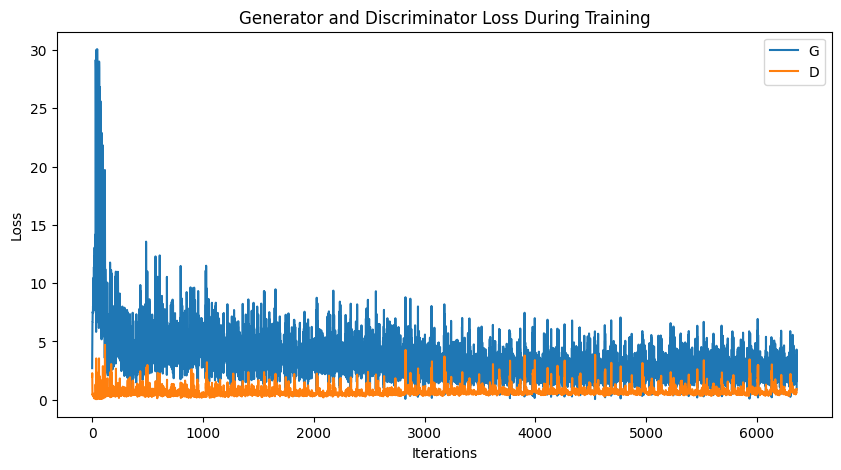

In [14]:
plt.figure(figsize=(10, 5))
plt.title('Generator and Discriminator Loss During Training')
plt.plot(g_losses, label='G')
plt.plot(d_losses, label='D')
plt.xlabel('Iterations')
plt.ylabel('Loss')
plt.legend()
plt.show()

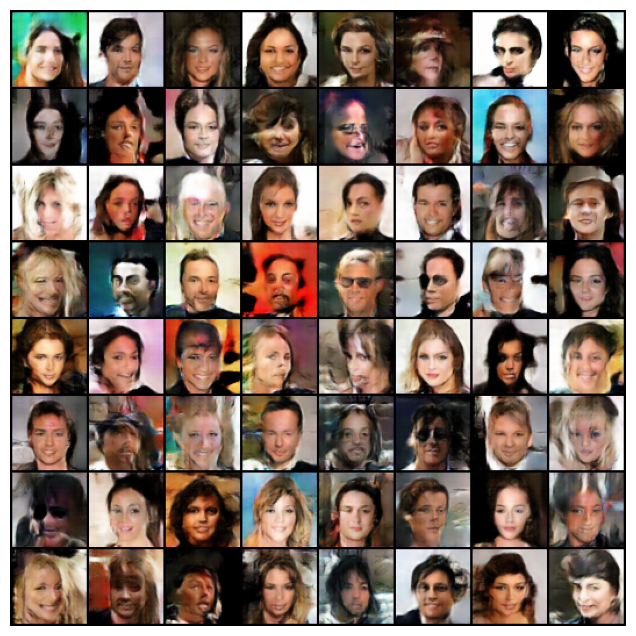

In [15]:
fig = plt.figure(figsize=(8, 8))
plt.axis('off')
ims = [[plt.imshow(np.transpose(i, (1, 2, 0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)
HTML(ani.to_jshtml())

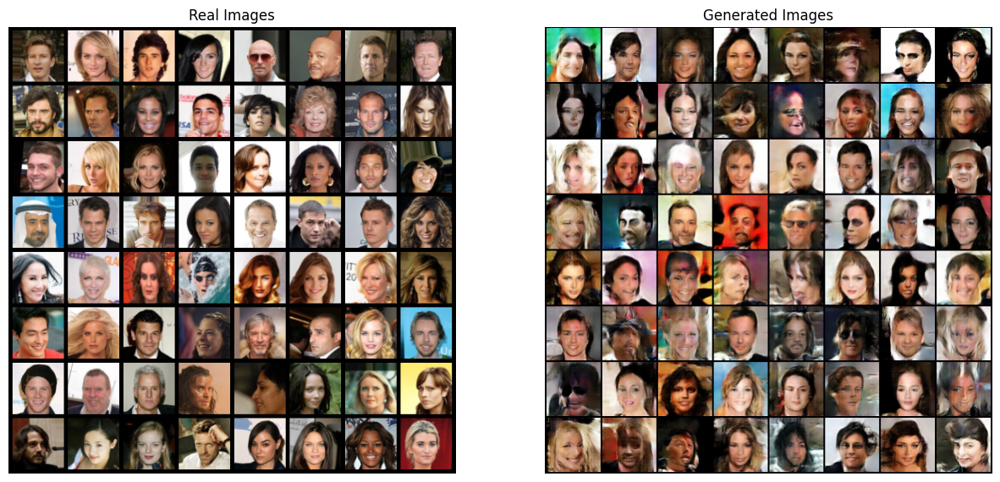

In [18]:
real_batch = next(iter(dataloader))

plt.figure(figsize=(15, 15))
plt.subplot(1, 2, 1)
plt.axis('off')
plt.title('Real Images')
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(), (1, 2, 0)))

plt.subplot(1, 2, 2)
plt.axis('off')
plt.title('Generated Images')
plt.imshow(np.transpose(img_list[-1], (1, 2, 0)))
plt.show()